# Convolutional Neural Networks for dog breed identification

---

### Dog breed detection

This project contains a Convolutional Neural Network for dog breed detection. If a dog is detected in the image, it will provide an estimate of the dog's breed.  If a human is detected, it will provide an estimate of the dog breed that is most resembling. Below there is an output sample:

![Sample Dog Output](images/sample_dog_output.png)


### Sections

The notebook is broken into separate sections/steps:
* [Step 0](#step0): Import Datasets
* [Step 1](#step1): Detect Humans
* [Step 2](#step2): Detect Dogs
* [Step 3](#step3): CNN to Classify Dog Breeds (from Scratch)
* [Step 4](#step4): CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 5](#step5): Algorithm
* [Step 6](#step6): Testing Algorithm

---
<a id='step0'></a>
## Step 0: Import Datasets

Download the required human and dog datasets:

* Download the [dog dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/dogImages.zip).  Unzip the folder and place it in this project's home directory, at the location `/dog_images`. 

* Download the [human dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/lfw.zip).  Unzip the folder and place it in the home directory, at location `/lfw`.  

Save the file paths for both the human (LFW) dataset and dog dataset in `human_files` and `dog_files`:

In [1]:
import numpy as np
from glob import glob

# load filenames for human and dog images
human_files = np.array(glob("/data/lfw/*/*"))
dog_files = np.array(glob("/data/dog_images/*/*/*"))

# print number of images in each dataset
print('There are %d total human images.' % len(human_files))
print('There are %d total dog images.' % len(dog_files))

There are 13233 total human images.
There are 8351 total dog images.


<a id='step1'></a>
## Step 1: Detect Humans

In this section, we use OpenCV's implementation of [Haar feature-based cascade classifiers](http://docs.opencv.org/trunk/d7/d8b/tutorial_py_face_detection.html) to detect human faces in images.  

We first convert the images to grayscale.  The `detectMultiScale` function executes the classifier stored in `face_cascade` and takes the grayscale image as a parameter.  

`faces` is a numpy array of detected faces, where each row corresponds to a detected face.  Each detected face is a 1D array with four entries that specifies the bounding box of the detected face.  The first two entries in the array (extracted in the above code as `x` and `y`) specify the horizontal and vertical positions of the top left corner of the bounding box.  The last two entries in the array (extracted here as `w` and `h`) specify the width and height of the box.

Number of faces detected: 1


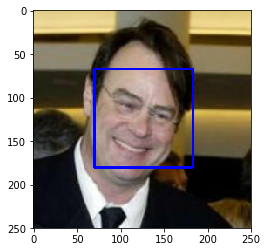

In [2]:
import cv2                
import matplotlib.pyplot as plt                        
%matplotlib inline                               

# extract pre-trained face detector
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# load color (BGR) image
img = cv2.imread(human_files[0])
# convert BGR image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# find faces in image
faces = face_cascade.detectMultiScale(gray)

# print number of faces detected in the image
print('Number of faces detected:', len(faces))

# get bounding box for each detected face
for (x,y,w,h) in faces:
    # add bounding box to color image
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    
# convert BGR image to RGB for plotting
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# display the image, along with bounding box
plt.imshow(cv_rgb)
plt.show()

### Human Face Detector

The following function uses OpenCV face detector to return `True` if a human face is detected in an image and `False` otherwise:

In [3]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

### Assess the Human Face Detector

We extract the file paths for the first 100 images from each of the datasets and store them in the numpy arrays `human_files_short` and `dog_files_short`.

Now let's test the performance of the `face_detector` function:
- 98% of images in human_files detected a human face
- 17% of images in dog_files detected a human face

In [8]:
from tqdm import tqdm

human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

## Test the performance of the face_detector algorithm 
## on the images in human_files_short and dog_files_short.
faces=0
for img_path in human_files_short:
    if face_detector(img_path):
        faces+=1
print(faces)

faces=0
for img_path in dog_files_short:
    if face_detector(img_path):
        faces+=1
print(faces)        

98
17


---
<a id='step2'></a>
## Step 2: Detect Dogs

In this section, we use a [pre-trained model](http://pytorch.org/docs/master/torchvision/models.html) to detect dogs in images.  

### Obtain Pre-trained VGG-16 Model

The code cell below downloads the VGG-16 model, along with weights that have been trained on [ImageNet](http://www.image-net.org/).

In [4]:
import torch
import torchvision.models as models
CUDA_LAUNCH_BLOCKING=1

# define VGG16 model
VGG16 = models.vgg16(pretrained=True)

# check if CUDA is available
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    VGG16 = VGG16.cuda()

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.torch/models/vgg16-397923af.pth
100%|██████████| 553433881/553433881 [00:07<00:00, 71634509.75it/s]


Given an image, this pre-trained VGG-16 model returns a prediction (derived from the 1000 possible categories in ImageNet) for the object that is contained in the image.

### Making Predictions with a Pre-trained Model

Wcreate a function that accepts a path to an image as input and returns the index corresponding to the ImageNet class that is predicted by the pre-trained VGG-16 model.  The output is an integer between 0 and 999, inclusive.

In [5]:
from PIL import Image
import torchvision.transforms as transforms

def VGG16_predict(img_path):
    '''
    Use pre-trained VGG-16 model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        
    Returns:
        Index corresponding to VGG-16 model's prediction
    '''
    
    ## Load and pre-process an image from the given img_path
    ## Return the *index* of the predicted class for that image
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])
    loader=transforms.Compose([
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        normalize,
    ])
    
    image = Image.open(img_path)
    image = loader(image).float()
    image = image.unsqueeze(0).cuda()     

    output = VGG16(image)
    _, pred = torch.max(output, 1)
    
    return  pred.data[0] # predicted class index

### Dog Detector

We note that in the [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a) the categories corresponding to dogs appear in an uninterrupted sequence and correspond to dictionary keys 151-268, including all categories from `'Chihuahua'` to `'Mexican hairless'`.  Thus, in order to check to see if an image is predicted to contain a dog by the pre-trained VGG-16 model, we need only check if the pre-trained model predicts an index between 151 and 268 (inclusive).

The `dog_detector` function below returns `True` if a dog is detected in an image (and `False` if not):

In [6]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    dog_index = VGG16_predict(img_path)
    if dog_index >151 and dog_index < 268:
        return True # true/false
    else:
        return False

### Assess the Dog Detector

Test the performance of `dog_detector` function:
- 1% of images in human_files_short detected a dog
- 91% of images in dog_files_short detected a dog

In [9]:
### Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.
dogs=0
for img_path in human_files_short:
    if dog_detector(img_path):
        dogs+=1
print(dogs)

dogs=0
for img_path in dog_files_short:
    if dog_detector(img_path):
        dogs+=1
print(dogs)    

1
91


---
<a id='step3'></a>
## Step 3: Create a CNN to Classify Dog Breeds (from Scratch)

Let's create a CNN that classifies dog breeds from scratch (without using transfer learning first). 

First, let's take a look at some pictures of different dog breeds that are very similar to get an idea of what would be the *human* accuracy:

Brittany | Welsh Springer Spaniel
- | - 
<img src="images/Brittany_02625.jpg" width="100"> | <img src="images/Welsh_springer_spaniel_08203.jpg" width="200">

Curly-Coated Retriever | American Water Spaniel
- | -
<img src="images/Curly-coated_retriever_03896.jpg" width="200"> | <img src="images/American_water_spaniel_00648.jpg" width="200">

Yellow Labrador | Chocolate Labrador | Black Labrador
- | - - | -
<img src="images/Labrador_retriever_06457.jpg" width="150"> | <img src="images/Labrador_retriever_06455.jpg" width="240"> | <img src="images/Labrador_retriever_06449.jpg" width="220">

Note that random chance presents an exceptionally low bar: setting aside the fact that the classes are slightly imabalanced, a random guess will provide a correct answer roughly 1 in 133 times, which corresponds to an accuracy of less than 1%.  

### Specify Data Loaders for the Dog Dataset

Let's create three separate data loaders for the training, validation, and test datasets of dog images (located at `dog_images/train`, `dog_images/valid`, and `dog_images/test`, respectively). 

VGG16 accepts images of size 224x224, so we resize the images to that size, and also normalize them as required by VGG16. Let's do soma data augmentation to the training set, but we do no augment the test dataset as one image could get a different result each time it is tested.

In [21]:
import os
from torchvision import datasets

import torchvision.transforms as transforms

# number of subprocesses to use for data loading
num_workers = 0
# how many samples per batch to load
batch_size = 20

# convert data to a normalized torch.FloatTensor
transform=transforms.Compose([
    transforms.CenterCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225]),
])

# choose the training and test datasets
train_data = datasets.ImageFolder('/data/dog_images/train',transform=transform)

transform=transforms.Compose([
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225]),
])

test_data = datasets.ImageFolder('/data/dog_images/test',transform=transform)
valid_data = datasets.ImageFolder('/data/dog_images/valid',transform=transform)

# prepare data loaders
loaders_scratch={}
loaders_scratch['train'] = torch.utils.data.DataLoader(train_data, batch_size=batch_size,
    num_workers=num_workers,shuffle=True)
loaders_scratch['valid'] = torch.utils.data.DataLoader(valid_data, batch_size=batch_size, 
    num_workers=num_workers,shuffle=True)
loaders_scratch['test'] = torch.utils.data.DataLoader(test_data, batch_size=batch_size, 
    num_workers=num_workers,shuffle=True)


### Model Architecture

In [11]:
import torch.nn as nn
import torch.nn.functional as F

#CNN architecture
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        ## Define layers of a CNN
        self.conv1 = nn.Conv2d(3, 16, 5,padding=2) 
        self.conv2 = nn.Conv2d(16, 32, 5,padding=2)
        self.conv3 = nn.Conv2d(32, 64, 5,padding=2)
        self.conv4 = nn.Conv2d(64, 128, 5,padding=2)
        self.pool = nn.MaxPool2d(2, 2)
        self.fc1 = nn.Linear(128 * 14 * 14, 1024) 
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 133)
        self.dropout=nn.Dropout(0.25)
        
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x))) #Convolution + Relu + Pooling
        x = self.pool(F.relu(self.conv2(x))) #Convolution + Relu + Pooling
        x = self.pool(F.relu(self.conv3(x))) #Convolution + Relu + Pooling
        x = self.pool(F.relu(self.conv4(x))) #Convolution + Relu + Pooling
        x = x.view(-1, 128 * 14 * 14) #Flatten
        x = self.dropout(F.relu(self.fc1(x))) #Linear layer + Relu + dropout
        x = self.dropout(F.relu(self.fc2(x))) #Linear layer + Relu + dropout
        x = self.fc3(x) #Output with 133 classes (no softmax)     
        return x

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()

### Loss Function and Optimizer

In [16]:
import torch.optim as optim

criterion_scratch = criterion = nn.CrossEntropyLoss()
optimizer_scratch = optim.SGD(model_scratch.parameters(),lr=0.001,momentum=0.9)

### Train and Validate the Model

In [17]:
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

def train(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path):
    """returns trained model"""
    # initialize tracker for minimum validation loss
    valid_loss_min = np.Inf 
    
    for epoch in range(1, n_epochs+1):
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        
        ###################
        # train the model #
        ###################
        model.train()
        for batch_idx, (data, target) in enumerate(loaders['train']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## find the loss and update the model parameters accordingly
            ## record the average training loss, using something like
            ## train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            
            # clear the gradients of all optimized variables
            optimizer.zero_grad()
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model(data)
            # calculate the batch loss
            loss = criterion(output, target)
            # backward pass: compute gradient of the loss with respect to model parameters
            loss.backward()
            # perform a single optimization step (parameter update)
            optimizer.step()
            # update training loss
            #train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            train_loss += loss.item() * data.size(0)
            
        ######################    
        # validate the model #
        ######################
        model.eval()
        for batch_idx, (data, target) in enumerate(loaders['valid']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            
            
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model(data)
            # calculate the batch loss
            loss = criterion(output, target)
            # update average validation loss 
            #valid_loss += valid_loss + ((1 / (batch_idx + 1)) * (loss.data - valid_loss))
            valid_loss += loss.item()*data.size(0)

        # calculate average losses
        train_loss = train_loss/len(loaders['train'])
        valid_loss = valid_loss/len(loaders['valid'])
        
        # print training/validation statistics 
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))
        
        ## save the model if validation loss has decreased
        if valid_loss <= valid_loss_min:
            print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
            valid_loss_min,
            valid_loss))
            torch.save(model.state_dict(), save_path)
            valid_loss_min = valid_loss
        
    # return trained model
    return model

In [22]:
# train the model
from workspace_utils import active_session
with active_session():
    model_scratch = train(80, loaders_scratch, model_scratch, optimizer_scratch, 
                      criterion_scratch, use_cuda, 'model_scratch.pt')

# load the model that got the best validation accuracy
model_scratch.load_state_dict(torch.load('model_scratch.pt'))

Epoch: 1 	Training Loss: 73.769123 	Validation Loss: 77.235167
Validation loss decreased (inf --> 77.235167).  Saving model ...
Epoch: 2 	Training Loss: 73.555956 	Validation Loss: 77.316506
Epoch: 3 	Training Loss: 73.033007 	Validation Loss: 75.038655
Validation loss decreased (77.235167 --> 75.038655).  Saving model ...
Epoch: 4 	Training Loss: 72.262949 	Validation Loss: 76.615069
Epoch: 5 	Training Loss: 71.589325 	Validation Loss: 75.220455
Epoch: 6 	Training Loss: 70.797544 	Validation Loss: 74.338213
Validation loss decreased (75.038655 --> 74.338213).  Saving model ...
Epoch: 7 	Training Loss: 70.139940 	Validation Loss: 74.601769
Epoch: 8 	Training Loss: 69.286952 	Validation Loss: 74.312798
Validation loss decreased (74.338213 --> 74.312798).  Saving model ...
Epoch: 9 	Training Loss: 68.805232 	Validation Loss: 74.363483
Epoch: 10 	Training Loss: 68.553252 	Validation Loss: 74.626431
Epoch: 11 	Training Loss: 68.036561 	Validation Loss: 74.662963
Epoch: 12 	Training Loss: 6

In [14]:
# load the model that got the best validation accuracy
model_scratch.load_state_dict(torch.load('model_scratch.pt'))

### Test the Model

In [16]:
def test(loaders, model, criterion, use_cuda):

    # monitor test loss and accuracy
    test_loss = 0.
    correct = 0.
    total = 0.

    model.eval()
    for batch_idx, (data, target) in enumerate(loaders['test']):
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the loss
        loss = criterion(output, target)
        # update average test loss 
        test_loss = test_loss + ((1 / (batch_idx + 1)) * (loss.data - test_loss))
        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))

# call test function    
test(loaders_scratch, model_scratch, criterion_scratch, use_cuda)

Test Loss: 3.281121


Test Accuracy: 24% (202/836)


---
<a id='step4'></a>
## Step 4: CNN to Classify Dog Breeds (using Transfer Learning)

Let's now use transfer learning to create a CNN that can identify dog breed from images.

### Specify Data Loaders for the Dog Dataset

In [25]:
import os
from torchvision import datasets
import torchvision.transforms as transforms

# number of subprocesses to use for data loading
num_workers = 0
# how many samples per batch to load
batch_size = 20

# convert data to a normalized torch.FloatTensor
transform=transforms.Compose([
    transforms.CenterCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225]),
])

# choose the training and test datasets
data_transfer={}
data_transfer['train'] = datasets.ImageFolder('/data/dog_images/train',transform=transform)

transform=transforms.Compose([
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225]),
])

data_transfer['test'] = datasets.ImageFolder('/data/dog_images/test',transform=transform)
data_transfer['valid'] = datasets.ImageFolder('/data/dog_images/valid',transform=transform)

# prepare data loaders
loaders_transfer={}
loaders_transfer['train'] = torch.utils.data.DataLoader(data_transfer['train'], batch_size=batch_size,
    num_workers=num_workers,shuffle=True)
loaders_transfer['valid'] = torch.utils.data.DataLoader(data_transfer['valid'], batch_size=batch_size, 
    num_workers=num_workers,shuffle=True)
loaders_transfer['test'] = torch.utils.data.DataLoader(data_transfer['test'], batch_size=batch_size, 
    num_workers=num_workers,shuffle=True)

### Model Architecture
We just removed the last year in the classifier of VGG and added two additional linear layers with ReLU, Batch norm and Dropout.

In [26]:
import torchvision.models as models
import torch.nn as nn

# Load the pretrained model from pytorch
model_transfer = models.vgg16(pretrained=True)

# print out the model structure
print(model_transfer)

# Freeze training for all "features" layers
for param in model_transfer.features.parameters():
    param.requires_grad = False

n_inputs = model_transfer.classifier[6].in_features

#Replace the last layer    
#model_transfer.classifier[6]=nn.Linear(n_inputs, 133)
model_transfer.classifier[6] = nn.Sequential(nn.Linear(n_inputs, 512),
                                     nn.ReLU(True),
                                     nn.BatchNorm1d(512),
                                     nn.Dropout(0.5),
                                     nn.Linear(512, 133))
print(model_transfer)

if use_cuda:
    model_transfer = model_transfer.cuda()

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (17): Conv2d

### Loss Function and Optimizer

In [27]:
criterion_transfer = nn.CrossEntropyLoss()
optimizer_transfer = optim.SGD(model_transfer.classifier.parameters(),lr=0.001,momentum=0.9)

### Train and Validate the Model

In [20]:
# train the model
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
from workspace_utils import active_session

with active_session():
    n_epochs=5
    model_transfer = train(n_epochs, loaders_transfer, model_transfer, optimizer_transfer, criterion_transfer, use_cuda, 'model_transfer.pt')

# load the model that got the best validation accuracy (uncomment the line below)
model_transfer.load_state_dict(torch.load('model_transfer.pt'))

Epoch: 1 	Training Loss: 73.767367 	Validation Loss: 52.053295
Validation loss decreased (inf --> 52.053295).  Saving model ...
Epoch: 2 	Training Loss: 47.130648 	Validation Loss: 37.070419
Validation loss decreased (52.053295 --> 37.070419).  Saving model ...
Epoch: 3 	Training Loss: 36.216111 	Validation Loss: 28.304036
Validation loss decreased (37.070419 --> 28.304036).  Saving model ...
Epoch: 4 	Training Loss: 30.398122 	Validation Loss: 26.747470
Validation loss decreased (28.304036 --> 26.747470).  Saving model ...
Epoch: 5 	Training Loss: 26.940571 	Validation Loss: 22.612927
Validation loss decreased (26.747470 --> 22.612927).  Saving model ...


In [28]:
# load the model that got the best validation accuracy (uncomment the line below)
model_transfer.load_state_dict(torch.load('model_transfer.pt'))

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images. Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 60%.

In [22]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 1.167655


Test Accuracy: 72% (609/836)


###  Predict Dog Breed with the Model

In [29]:
# list of class names by index, i.e. a name can be accessed like class_names[0]
class_names = [item[4:].replace("_", " ") for item in data_transfer['train'].classes]

def predict_breed_transfer(img_path):
    model_transfer.eval()
    
    loader=transforms.Compose([
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225])])
    
    image = Image.open(img_path)
    image = loader(image).float()
    image = image.unsqueeze(0).cuda()     
    
    # load the image and return the predicted breed
    output = model_transfer(image)
    # convert output probabilities to predicted class
    #_, pred = torch.max(output, 1)
    pred = output.data.max(1, keepdim=True)[1]
    
    return class_names[pred]

---
<a id='step5'></a>
## Algorithm

To further test our model, let's write an algorithm that accepts a file path to an image and first determines whether the image contains a human, dog, or neither.  Then,
- if a __dog__ is detected in the image, return the predicted breed.
- if a __human__ is detected in the image, return the resembling dog breed.
- if __neither__ is detected in the image, provide output that indicates an error.

Hello dog! You look like a Chesapeake bay retriever


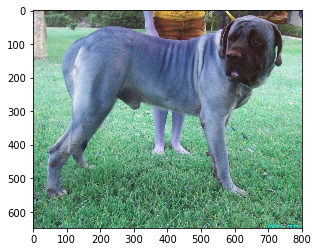

Hello dog! You look like a Mastiff


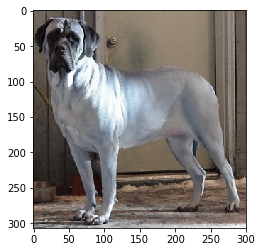

Hello dog! You look like a Bullmastiff


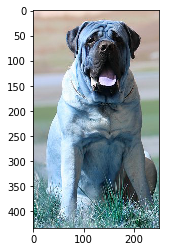

No dog or human faces


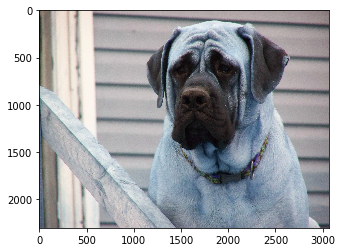

Hello dog! You look like a Mastiff


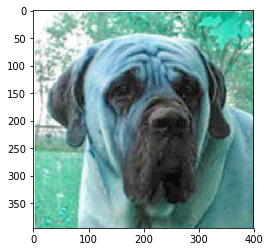

Hello dog! You look like a Mastiff


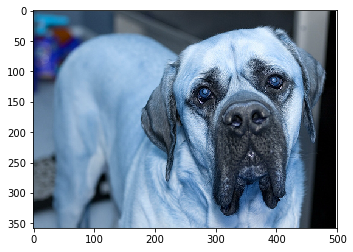

Hello dog! You look like a Cane corso


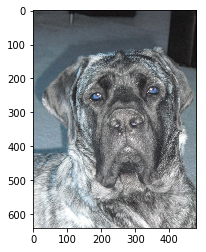

Hello dog! You look like a Mastiff


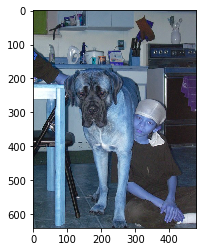

Hello dog! You look like a Chinese shar-pei


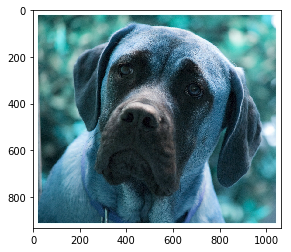

Hello dog! You look like a Cane corso


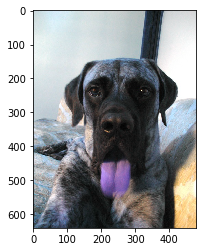

Hello dog! You look like a Mastiff


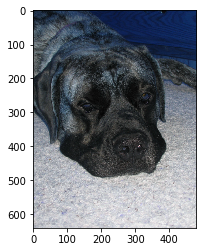

Hello dog! You look like a Mastiff


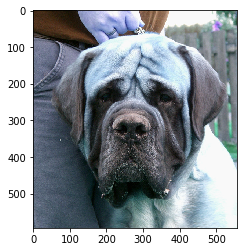

Hello dog! You look like a Mastiff


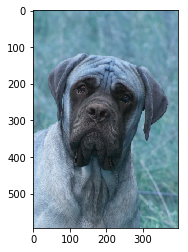

Hello dog! You look like a Mastiff


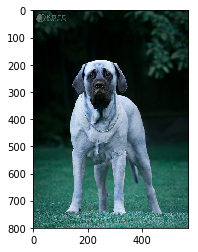

Hello dog! You look like a Mastiff


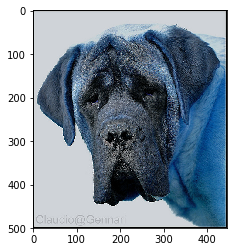

Hello dog! You look like a Mastiff


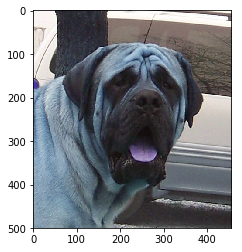

Hello dog! You look like a Bullmastiff


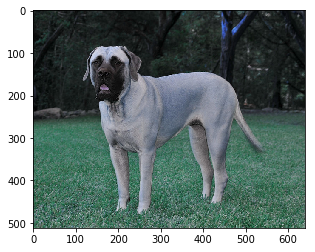

Hello dog! You look like a Mastiff


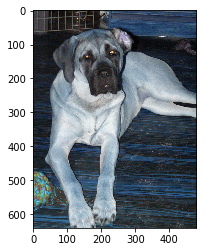

Hello dog! You look like a Mastiff


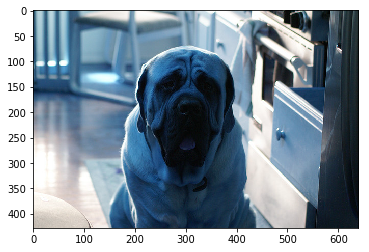

Hello dog! You look like a German shorthaired pointer


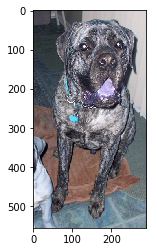

Hello dog! You look like a Mastiff


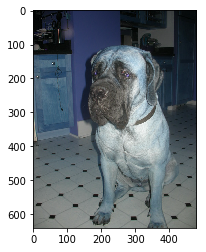

Hello dog! You look like a Greyhound


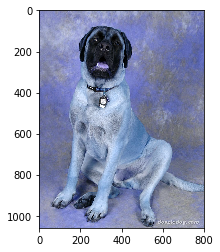

Hello dog! You look like a Mastiff


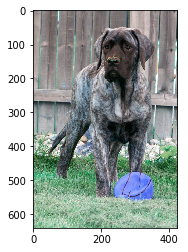

Hello dog! You look like a Mastiff


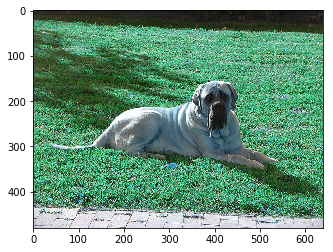

Hello dog! You look like a Mastiff


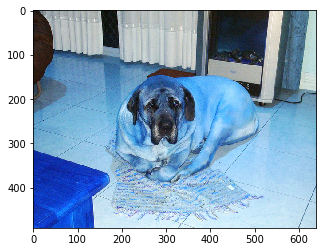

Hello dog! You look like a Mastiff


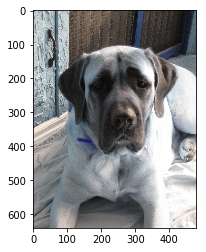

Hello human! You look like a Cane corso


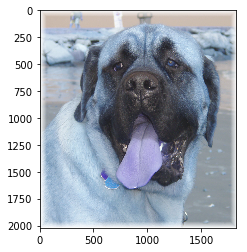

Hello dog! You look like a Bullmastiff


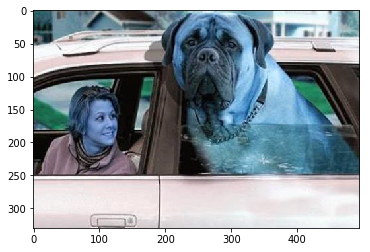

Hello dog! You look like a Mastiff


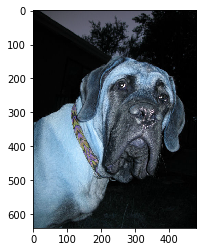

Hello dog! You look like a Mastiff


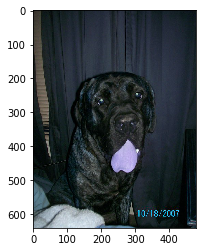

Hello dog! You look like a Mastiff


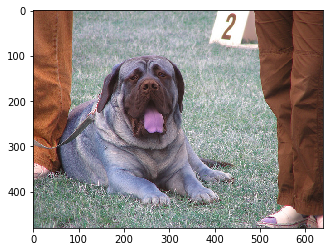

Hello dog! You look like a Cane corso


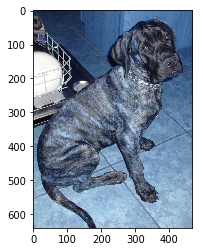

Hello dog! You look like a Mastiff


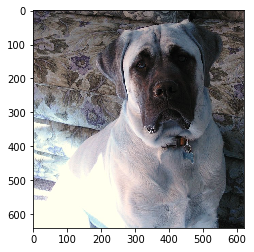

Hello dog! You look like a Anatolian shepherd dog


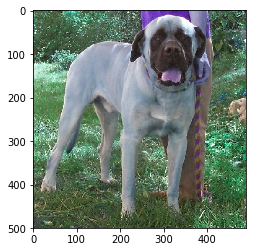

Hello dog! You look like a Bullmastiff


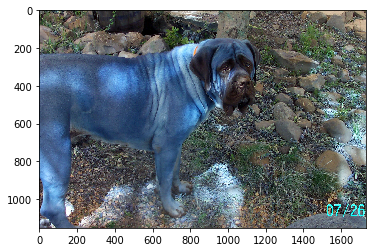

Hello dog! You look like a Mastiff


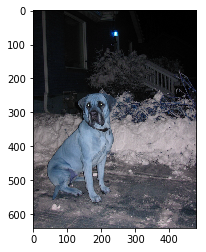

No dog or human faces


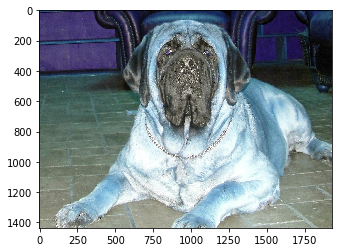

Hello dog! You look like a Bullmastiff


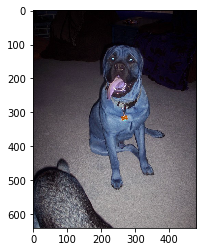

Hello dog! You look like a Mastiff


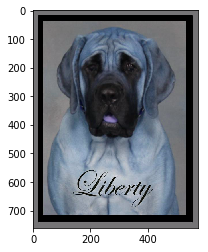

Hello dog! You look like a German shorthaired pointer


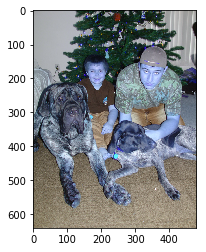

Hello dog! You look like a Anatolian shepherd dog


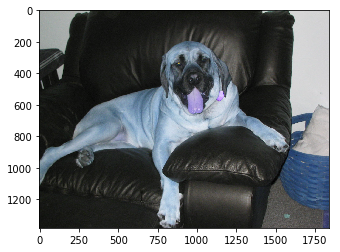

Hello dog! You look like a Mastiff


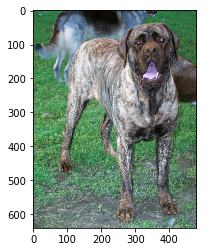

Hello dog! You look like a Bulldog


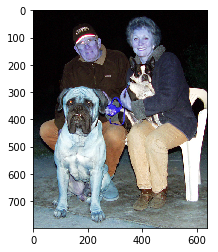

Hello dog! You look like a Mastiff


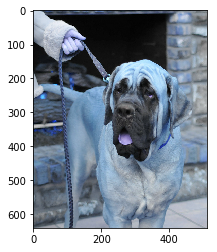

Hello dog! You look like a Mastiff


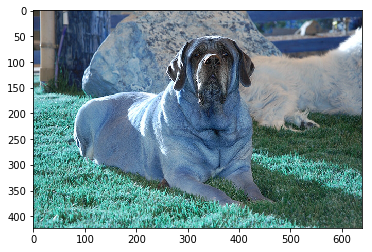

Hello dog! You look like a Bullmastiff


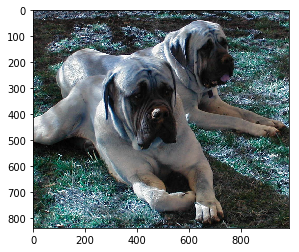

Hello dog! You look like a Anatolian shepherd dog


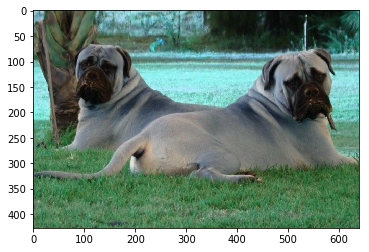

Hello dog! You look like a Mastiff


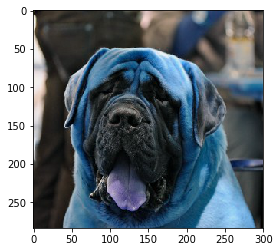

Hello dog! You look like a Mastiff


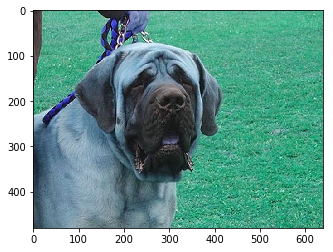

Hello dog! You look like a Mastiff


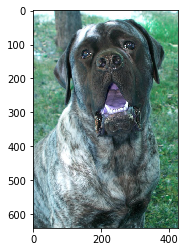

Hello dog! You look like a Mastiff


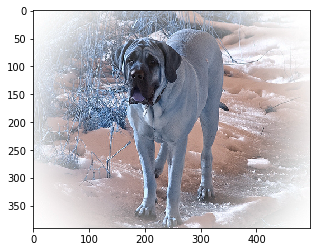

Hello dog! You look like a Mastiff


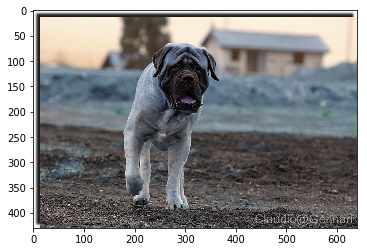

Hello dog! You look like a Bulldog


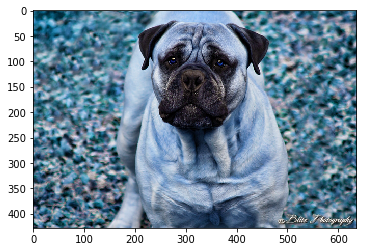

No dog or human faces


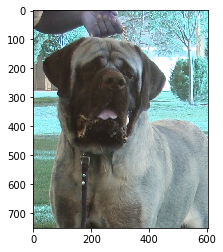

Hello dog! You look like a Mastiff


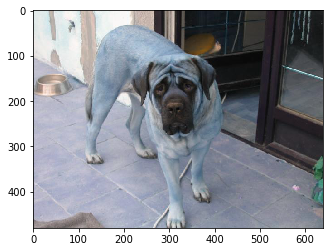

Hello dog! You look like a Mastiff


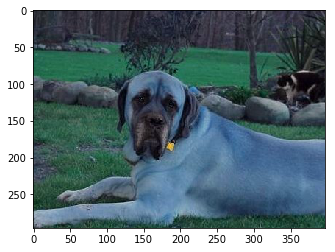

Hello dog! You look like a Bloodhound


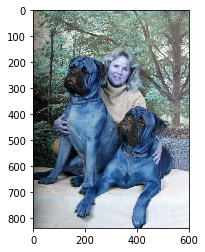

Hello dog! You look like a Mastiff


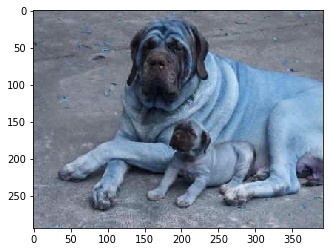

Hello dog! You look like a Doberman pinscher


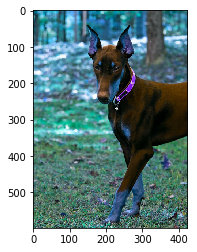

Hello dog! You look like a Black and tan coonhound


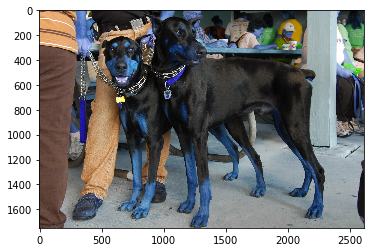

Hello dog! You look like a Doberman pinscher


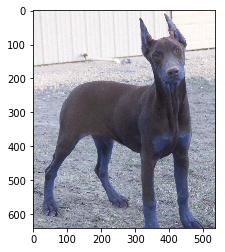

Hello dog! You look like a Cane corso


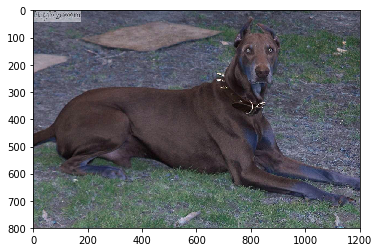

Hello dog! You look like a Doberman pinscher


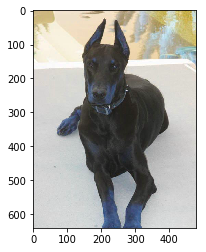

Hello dog! You look like a Doberman pinscher


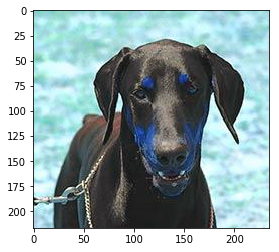

Hello dog! You look like a Doberman pinscher


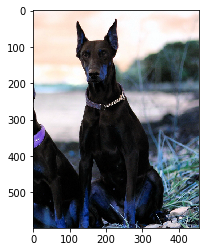

Hello dog! You look like a Doberman pinscher


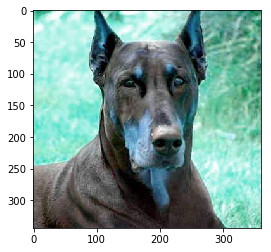

Hello dog! You look like a Doberman pinscher


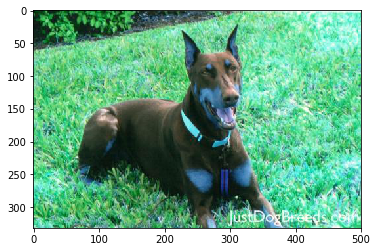

Hello dog! You look like a Doberman pinscher


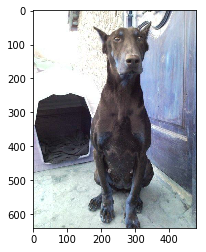

Hello dog! You look like a Beauceron


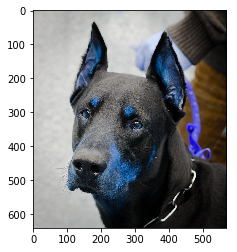

Hello dog! You look like a German pinscher


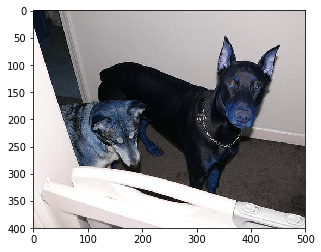

Hello dog! You look like a Doberman pinscher


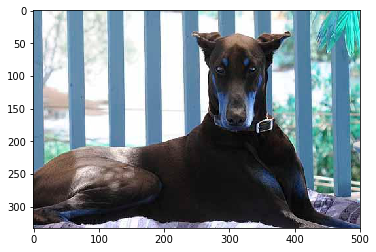

Hello human! You look like a Cane corso


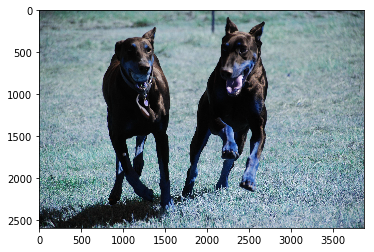

Hello dog! You look like a Doberman pinscher


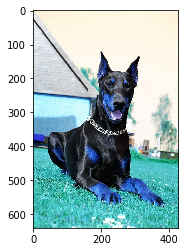

Hello dog! You look like a Doberman pinscher


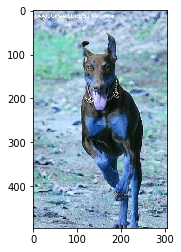

Hello dog! You look like a Dachshund


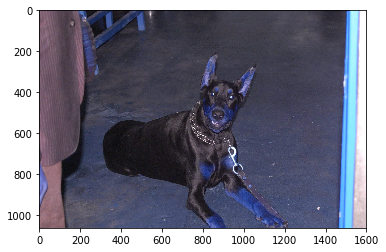

Hello dog! You look like a Dachshund


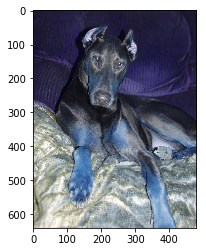

Hello dog! You look like a German pinscher


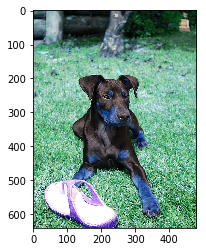

Hello dog! You look like a Doberman pinscher


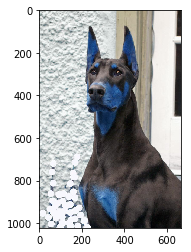

Hello dog! You look like a Doberman pinscher


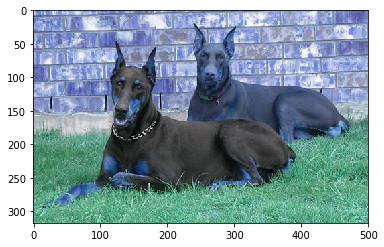

Hello human! You look like a Dogue de bordeaux


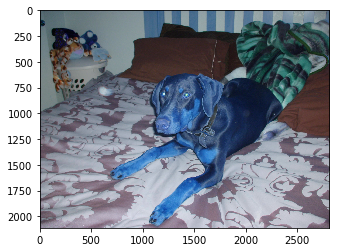

Hello dog! You look like a Doberman pinscher


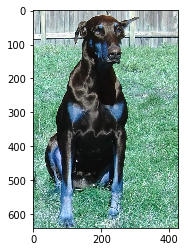

Hello dog! You look like a Doberman pinscher


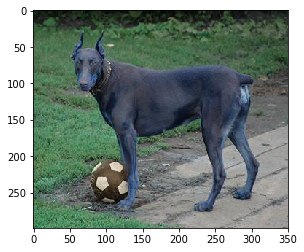

Hello dog! You look like a Doberman pinscher


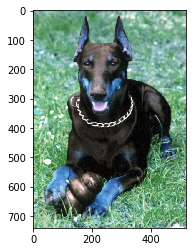

Hello dog! You look like a Doberman pinscher


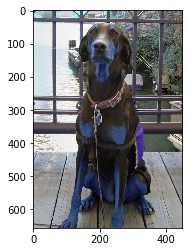

Hello human! You look like a Dogue de bordeaux


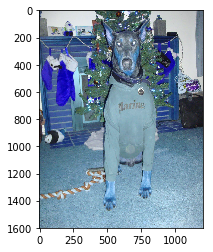

Hello dog! You look like a Doberman pinscher


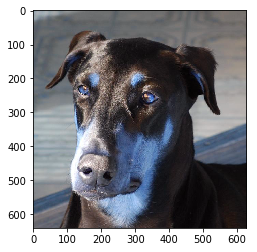

Hello dog! You look like a Doberman pinscher


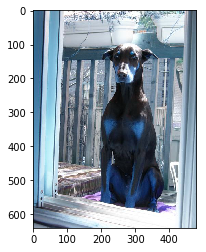

No dog or human faces


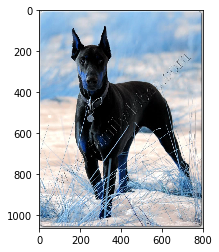

Hello dog! You look like a Doberman pinscher


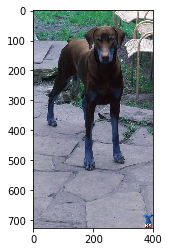

Hello human! You look like a Cane corso


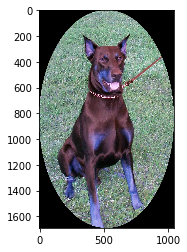

Hello dog! You look like a Doberman pinscher


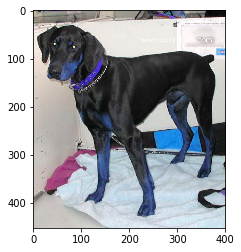

Hello dog! You look like a Doberman pinscher


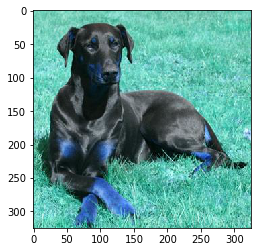

Hello dog! You look like a Doberman pinscher


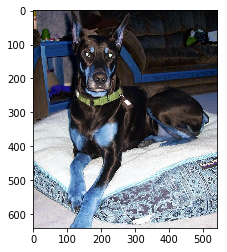

Hello dog! You look like a Doberman pinscher


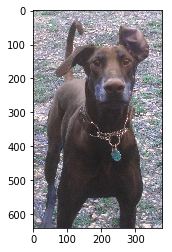

Hello dog! You look like a Doberman pinscher


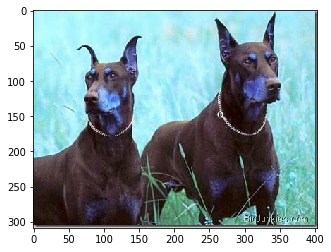

Hello dog! You look like a Black and tan coonhound


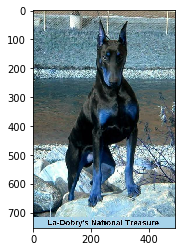

Hello dog! You look like a German pinscher


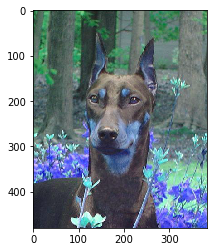

Hello dog! You look like a Doberman pinscher


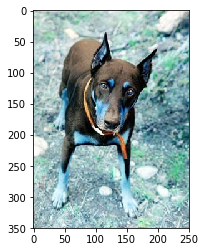

Hello dog! You look like a Doberman pinscher


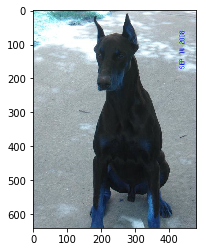

Hello dog! You look like a Doberman pinscher


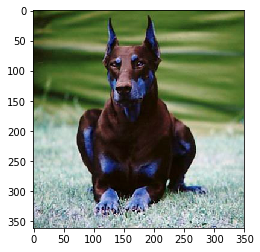

Hello human! You look like a American foxhound


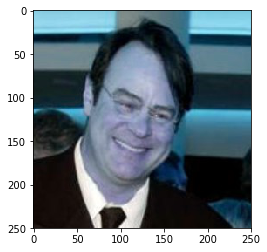

Hello human! You look like a Alaskan malamute


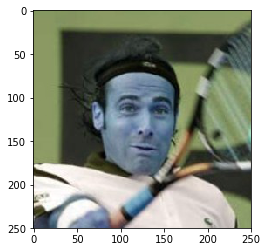

Hello human! You look like a Otterhound


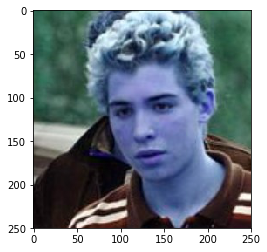

Hello human! You look like a Ibizan hound


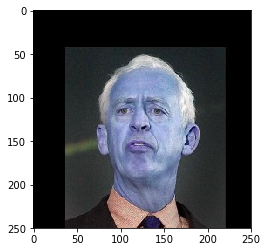

Hello human! You look like a American staffordshire terrier


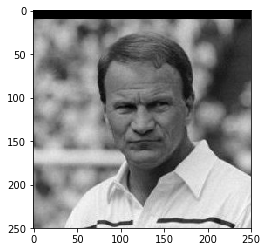

Hello human! You look like a Dachshund


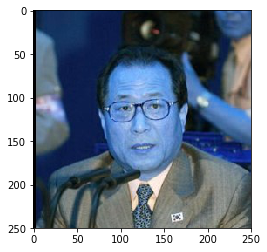

Hello human! You look like a Brittany


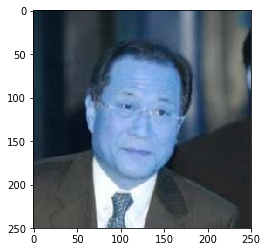

Hello human! You look like a Dachshund


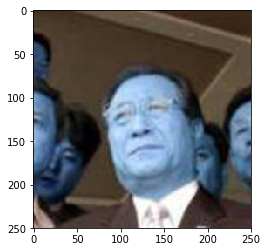

Hello human! You look like a Dachshund


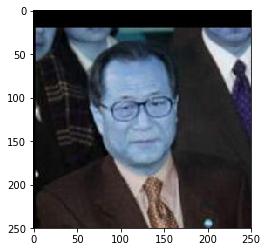

Hello human! You look like a Dachshund


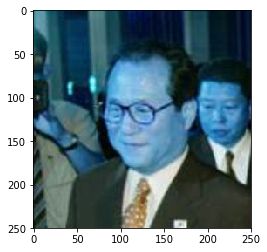

Hello human! You look like a American staffordshire terrier


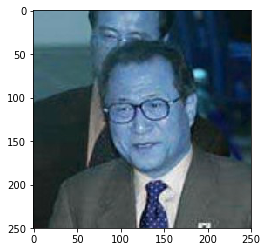

Hello human! You look like a Dachshund


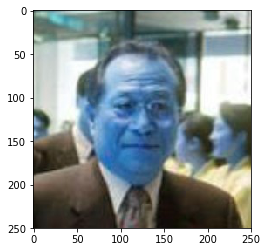

Hello human! You look like a Dachshund


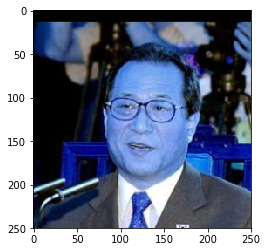

Hello human! You look like a Dachshund


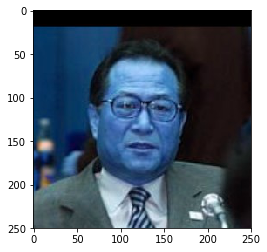

Hello human! You look like a Dachshund


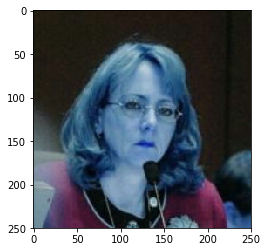

Hello human! You look like a German wirehaired pointer


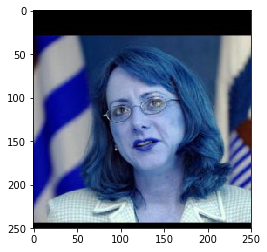

Hello human! You look like a Dachshund


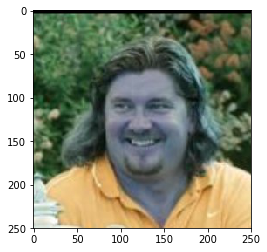

Hello human! You look like a Dachshund


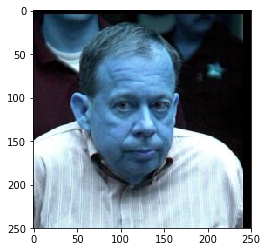

Hello human! You look like a Boykin spaniel


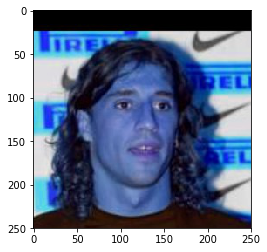

Hello human! You look like a American foxhound


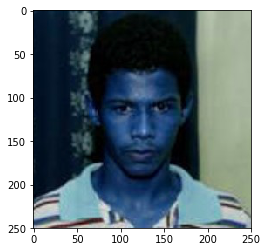

Hello human! You look like a Dachshund


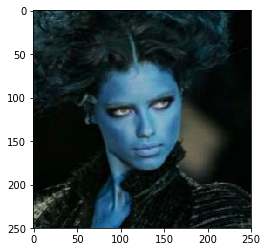

Hello human! You look like a Chinese crested


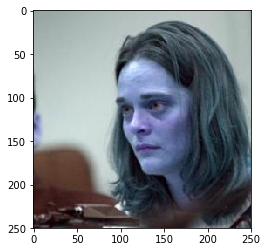

Hello human! You look like a Dachshund


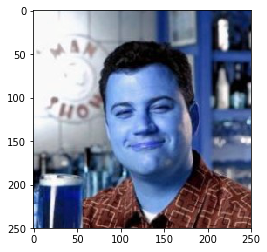

Hello human! You look like a Canaan dog


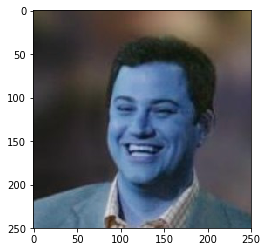

Hello human! You look like a Dachshund


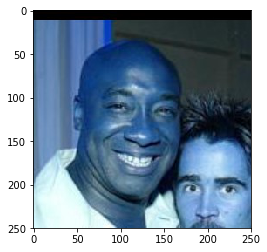

Hello human! You look like a Chinese crested


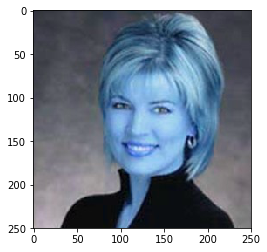

Hello human! You look like a Dachshund


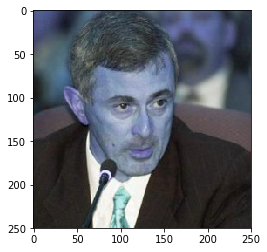

Hello human! You look like a German wirehaired pointer


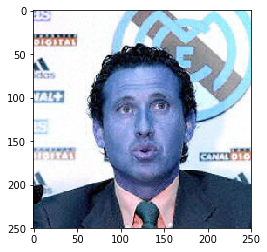

Hello human! You look like a Plott


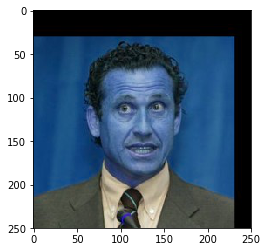

Hello human! You look like a Dachshund


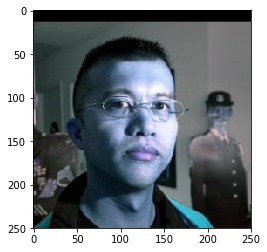

Hello human! You look like a Dachshund


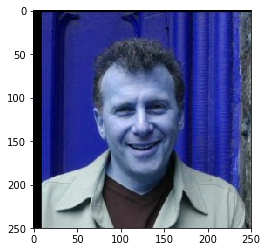

Hello human! You look like a Dachshund


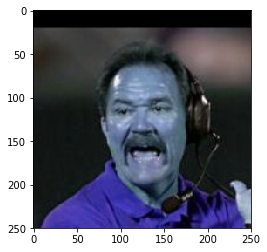

Hello human! You look like a Beagle


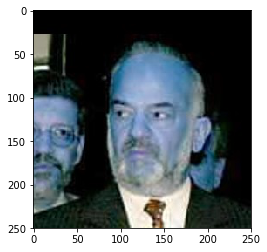

Hello human! You look like a Pharaoh hound


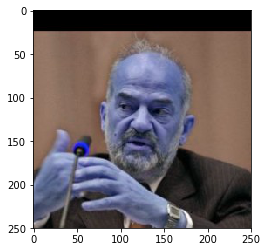

Hello human! You look like a Dachshund


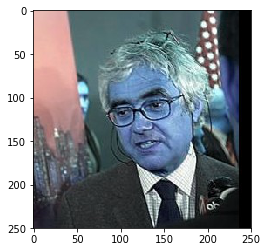

Hello human! You look like a Chinese crested


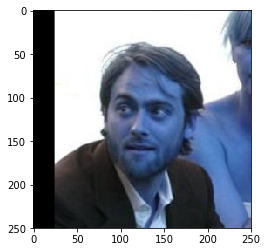

Hello human! You look like a Dachshund


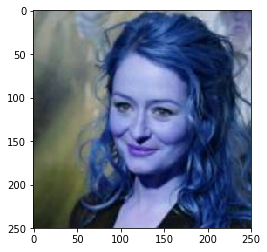

Hello human! You look like a American staffordshire terrier


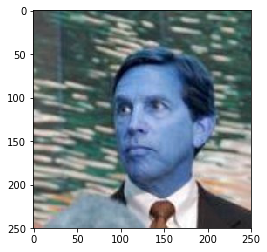

Hello human! You look like a Dachshund


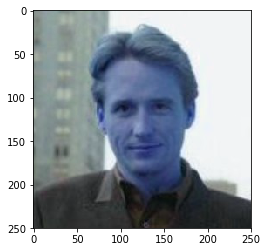

Hello human! You look like a American staffordshire terrier


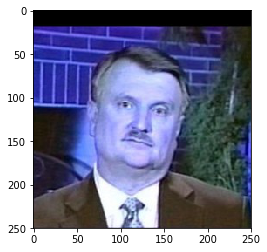

Hello human! You look like a Alaskan malamute


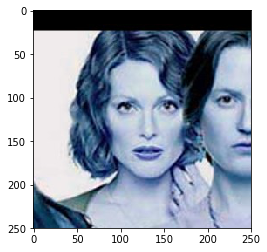

Hello human! You look like a Dachshund


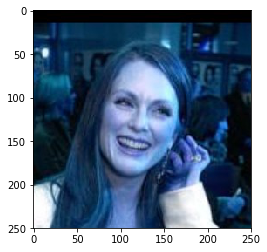

Hello human! You look like a Boykin spaniel


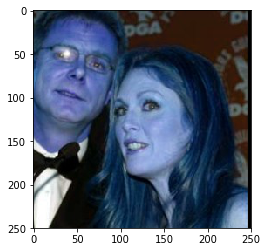

Hello human! You look like a Dachshund


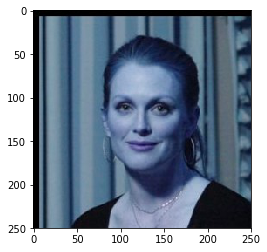

Hello human! You look like a Chinese crested


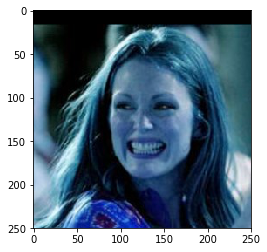

Hello human! You look like a Poodle


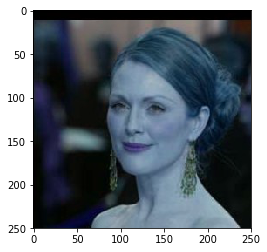

Hello human! You look like a Dachshund


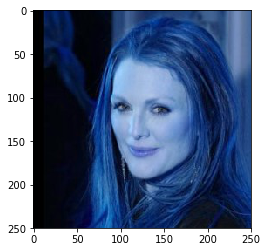

Hello human! You look like a Dachshund


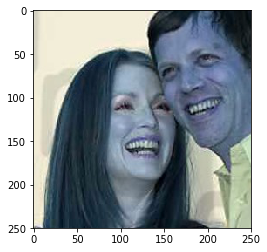

Hello human! You look like a Afghan hound


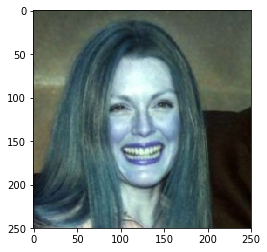

Hello human! You look like a Dachshund


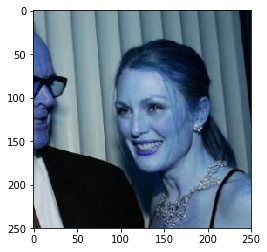

Hello human! You look like a Dachshund


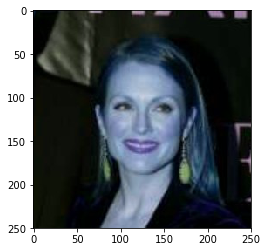

Hello human! You look like a English springer spaniel


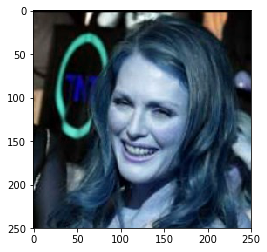

Hello human! You look like a Dachshund


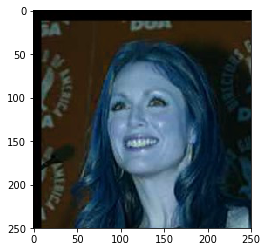

Hello human! You look like a Dachshund


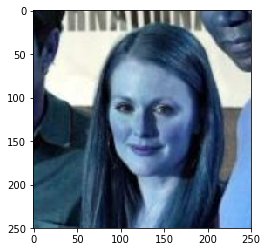

Hello human! You look like a Afghan hound


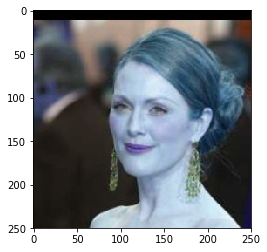

Hello human! You look like a Dachshund


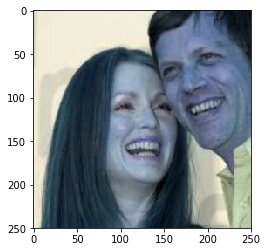

No dog or human faces


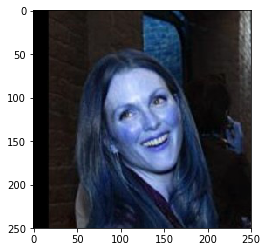

Hello human! You look like a Dachshund


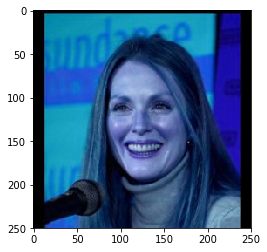

Hello human! You look like a English springer spaniel


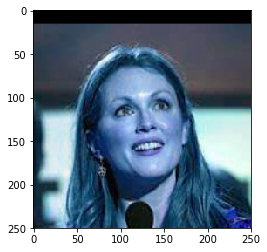

Hello human! You look like a Dachshund


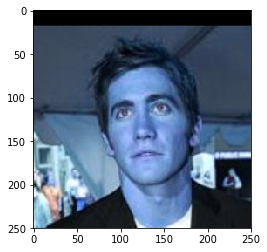

Hello human! You look like a Dachshund


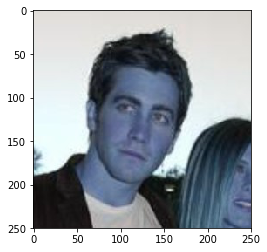

Hello human! You look like a Afghan hound


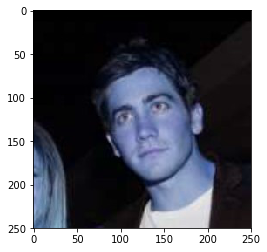

Hello human! You look like a German wirehaired pointer


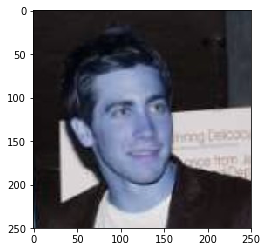

Hello human! You look like a American staffordshire terrier


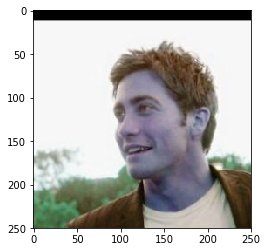

Hello human! You look like a Brittany


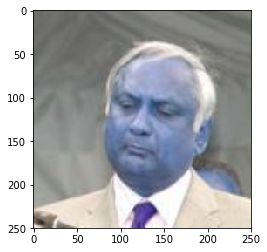

Hello human! You look like a American staffordshire terrier


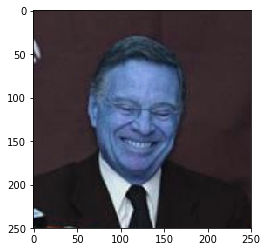

Hello human! You look like a Dachshund


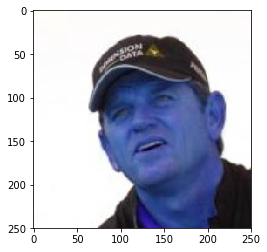

Hello human! You look like a Dachshund


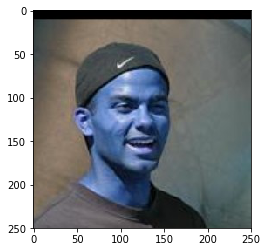

Hello human! You look like a Dachshund


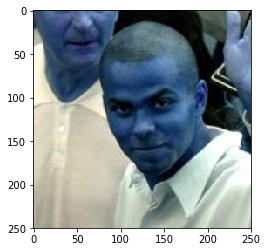

Hello human! You look like a Dachshund


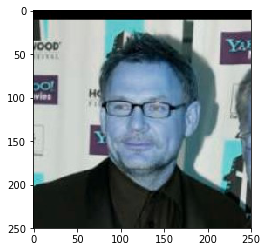

Hello human! You look like a Dachshund


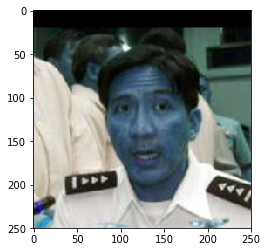

Hello human! You look like a Boykin spaniel


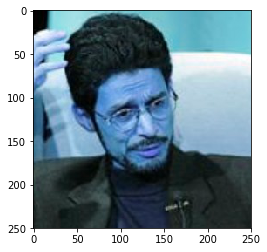

Hello human! You look like a Dachshund


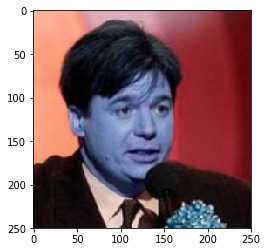

Hello human! You look like a German wirehaired pointer


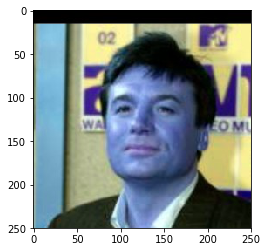

Hello human! You look like a Alaskan malamute


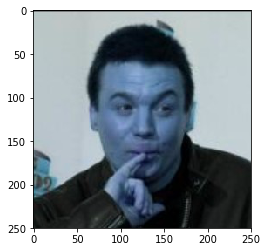

Hello human! You look like a Dachshund


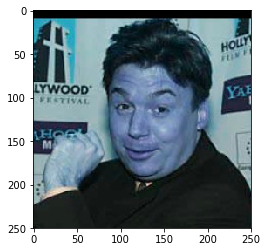

Hello human! You look like a American staffordshire terrier


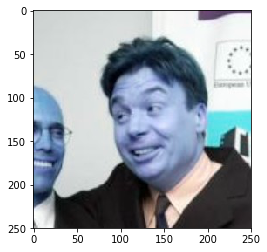

Hello human! You look like a Dachshund


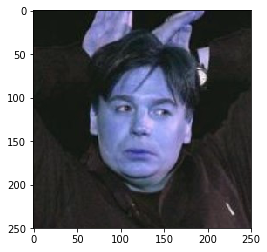

Hello human! You look like a American staffordshire terrier


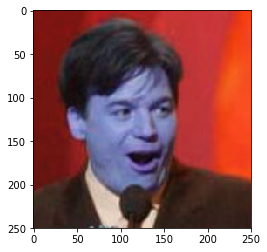

Hello human! You look like a Nova scotia duck tolling retriever


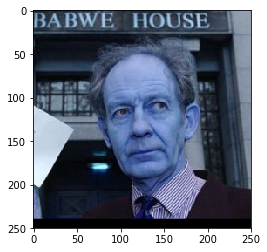

Hello human! You look like a American staffordshire terrier


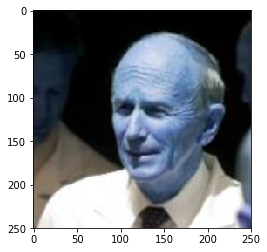

Hello human! You look like a Dachshund


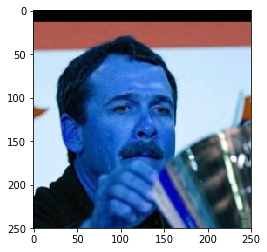

Hello human! You look like a Brittany


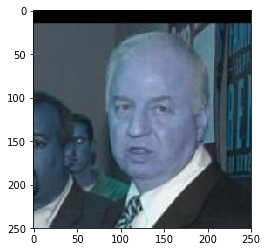

Hello human! You look like a German wirehaired pointer


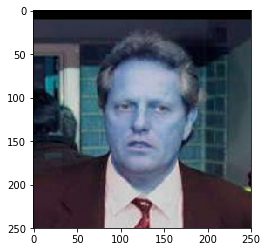

Hello human! You look like a American staffordshire terrier


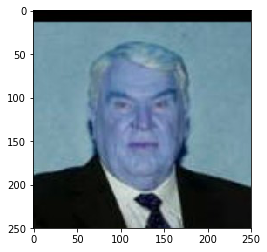

Hello human! You look like a Dachshund


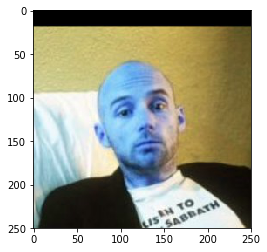

Hello human! You look like a Brittany


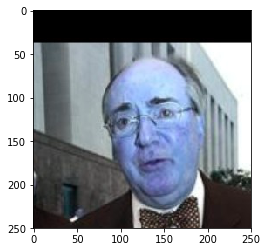

No dog or human faces


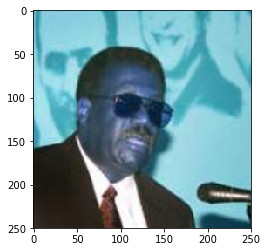

Hello human! You look like a Irish water spaniel


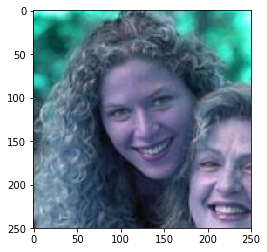

Hello human! You look like a American staffordshire terrier


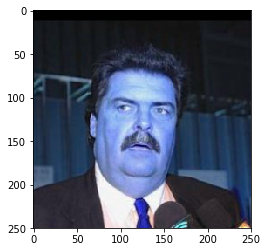

Hello human! You look like a Dachshund


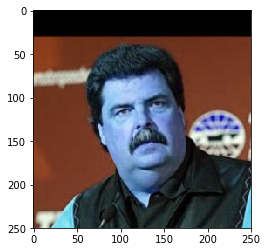

Hello human! You look like a American staffordshire terrier


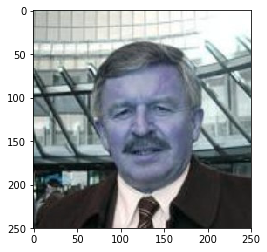

Hello human! You look like a Dachshund


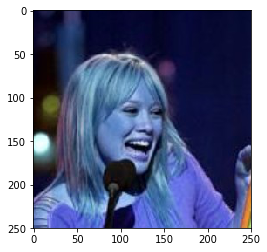

Hello human! You look like a Chinese crested


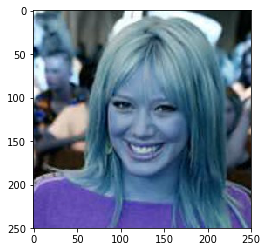

Hello human! You look like a Chinese crested


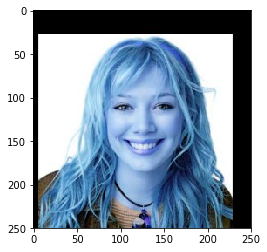

Hello human! You look like a Dachshund


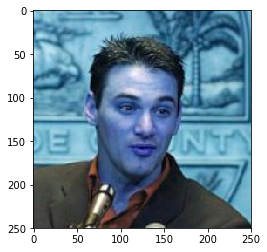

Hello human! You look like a Dachshund


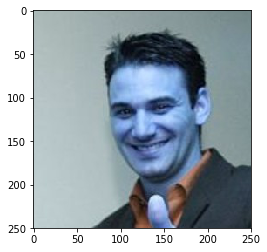

Hello human! You look like a Chinese crested


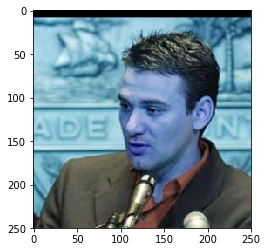

Hello human! You look like a Dachshund


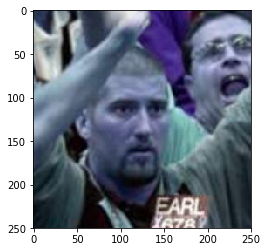

Hello human! You look like a Dachshund


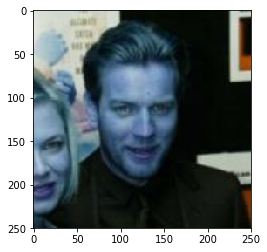

In [34]:
def run_app(img_path):
    ## handle cases for a human face, dog, and neither
    if dog_detector(img_path):
        return predict_breed_transfer(img_path),'dog'
    elif face_detector(img_path):
        return predict_breed_transfer(img_path),'human'
    else:
        return 'None','None'

for img_path in dog_files_short:

    breed,human_dog=run_app(img_path)
    
    if breed!='None':
        print('Hello ' + human_dog + '! You look like a ' + breed)    
    else:
        print('No dog or human faces')
            
    img = cv2.imread(img_path)
    plt.imshow(img)
    plt.show()
    

for img_path in human_files_short:
    breed,human_dog=run_app(img_path)

    if breed!='None':
        print('Hello ' + human_dog + '! You look like a ' + breed)      
    else:
        print('No dog or human faces')
        
    img = cv2.imread(img_path)
    plt.imshow(img)
    plt.show()

---
<a id='step6'></a>

## Step 6: Test Algorithm
Let's test the algorithm with other images other than our datatest set ones. Note that the algorithm only misses one picture of a dog, where it doesn't detect his face, which is understandable because it has his tongue hanging and the training dataset may not have many images like this. The algorithm could be improved by training on more dog breeds, including images of dogs in different positions where you can't see their face directly (from the back, sidewards, etc), and including more pictures of dogs showing their tongue, as it fails in some of these images.

No dog or human faces


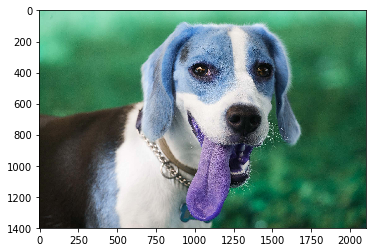

Hello human! You look like a Plott


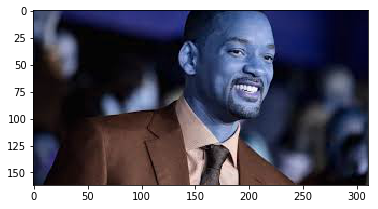

Hello human! You look like a Dachshund


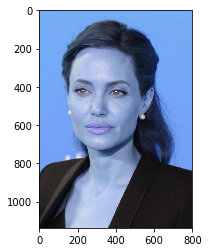

Hello human! You look like a Poodle


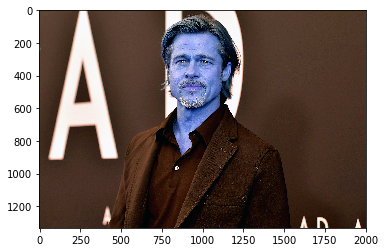

Hello dog! You look like a Basenji


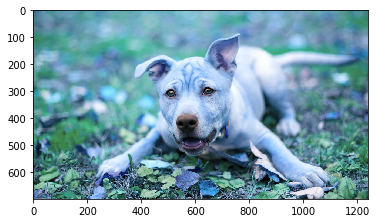

Hello dog! You look like a Norwegian lundehund


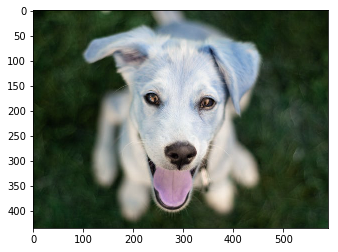

Hello dog! You look like a Golden retriever


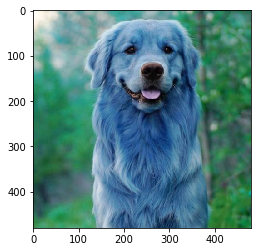

In [39]:
my_files=np.array(glob("./My_images/*"))

for file in my_files:
    breed,human_dog=run_app(file)
    if breed!='None':
        print('Hello ' + human_dog + '! You look like a ' + breed)      
    else:
        print('No dog or human faces')
    
    img = cv2.imread(file)
    plt.imshow(img)
    plt.show()        